In [42]:
# Python ≥3.5 is required
import sys
assert sys.version_info >= (3, 5)

# Scikit-Learn ≥0.20 is required
import sklearn
assert sklearn.__version__ >= "0.20"

# Common imports
import numpy as np
import os

# To plot pretty figures
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

# Where to save the figures
PROJECT_ROOT_DIR = "."
CHAPTER_ID = "house_prices_regression_model"
IMAGES_PATH = os.path.join(PROJECT_ROOT_DIR, "images", CHAPTER_ID)
os.makedirs(IMAGES_PATH, exist_ok=True)

def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    path = os.path.join(IMAGES_PATH, fig_id + "." + fig_extension)
    print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format=fig_extension, dpi=resolution)

# Ignore useless warnings (see SciPy issue #5998)
import warnings
warnings.filterwarnings(action="ignore", message="^internal gelsd")

In [43]:
#https://www.kaggle.com/c/5407/download-all

## Get/Load the data

In [44]:
import pandas as pd

#specify housing data folder name within project directory
housing_data_folder_path = os.path.join(PROJECT_ROOT_DIR, "data_source")

def load_housing_data(housing_filename):
    csv_path = os.path.join(housing_data_folder_path, housing_filename)
    return pd.read_csv(csv_path)

In [45]:
housing = load_housing_data(housing_filename = "train.csv")
housing.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


## Data exploration

In [46]:
housing.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
Id               1460 non-null int64
MSSubClass       1460 non-null int64
MSZoning         1460 non-null object
LotFrontage      1201 non-null float64
LotArea          1460 non-null int64
Street           1460 non-null object
Alley            91 non-null object
LotShape         1460 non-null object
LandContour      1460 non-null object
Utilities        1460 non-null object
LotConfig        1460 non-null object
LandSlope        1460 non-null object
Neighborhood     1460 non-null object
Condition1       1460 non-null object
Condition2       1460 non-null object
BldgType         1460 non-null object
HouseStyle       1460 non-null object
OverallQual      1460 non-null int64
OverallCond      1460 non-null int64
YearBuilt        1460 non-null int64
YearRemodAdd     1460 non-null int64
RoofStyle        1460 non-null object
RoofMatl         1460 non-null object
Exterior1st      1460 non-n

In [47]:
housing.describe()

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,...,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,1460.000000,1460.000000,1201.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1452.000000,1460.000000,...,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,730.500000,56.897260,70.049958,10516.828082,6.099315,5.575342,1971.267808,1984.865753,103.685262,443.639726,...,94.244521,46.660274,21.954110,3.409589,15.060959,2.758904,43.489041,6.321918,2007.815753,180921.195890
std,421.610009,42.300571,24.284752,9981.264932,1.382997,1.112799,30.202904,20.645407,181.066207,456.098091,...,125.338794,66.256028,61.119149,29.317331,55.757415,40.177307,496.123024,2.703626,1.328095,79442.502883
min,1.000000,20.000000,21.000000,1300.000000,1.000000,1.000000,1872.000000,1950.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,34900.000000
25%,365.750000,20.000000,59.000000,7553.500000,5.000000,5.000000,1954.000000,1967.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.000000,129975.000000
50%,730.500000,50.000000,69.000000,9478.500000,6.000000,5.000000,1973.000000,1994.000000,0.000000,383.500000,...,0.000000,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,163000.000000
75%,1095.250000,70.000000,80.000000,11601.500000,7.000000,6.000000,2000.000000,2004.000000,166.000000,712.250000,...,168.000000,68.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000,214000.000000
max,1460.000000,190.000000,313.000000,215245.000000,10.000000,9.000000,2010.000000,2010.000000,1600.000000,5644.000000,...,857.000000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,2010.000000,755000.000000


In [48]:
#What % of missing values within features?

def calculate_missing_value_percentage(df):
    col = [str(col) for col in df.columns]
    percent_missing_values = [round((df[col].isnull().sum())/(len(df[col]))*100) for col in df.columns]
    temp_df = pd.DataFrame(data={"Feature":col, "Percentage":percent_missing_values})
    temp_df = temp_df.sort_values('Percentage', ascending=False)

    return temp_df

missing_value_percentage = calculate_missing_value_percentage(housing)
missing_value_percentage.head()


,Feature,Percentage
72,PoolQC,100.0
74,MiscFeature,96.0
6,Alley,94.0
73,Fence,81.0
57,FireplaceQu,47.0


In [49]:
# Dropping "Alley" feature due to high number of NaNs. Difficult/naive to impute values from 6% of data. 

# Similarily dropping : FireplaceQu, PoolQC,Fence, MiscFeature 

housing = housing.drop(['Alley', 'FireplaceQu', 'PoolQC', 'Fence', 'MiscFeature'], axis=1)


Saving figure attribute_histogram_plots


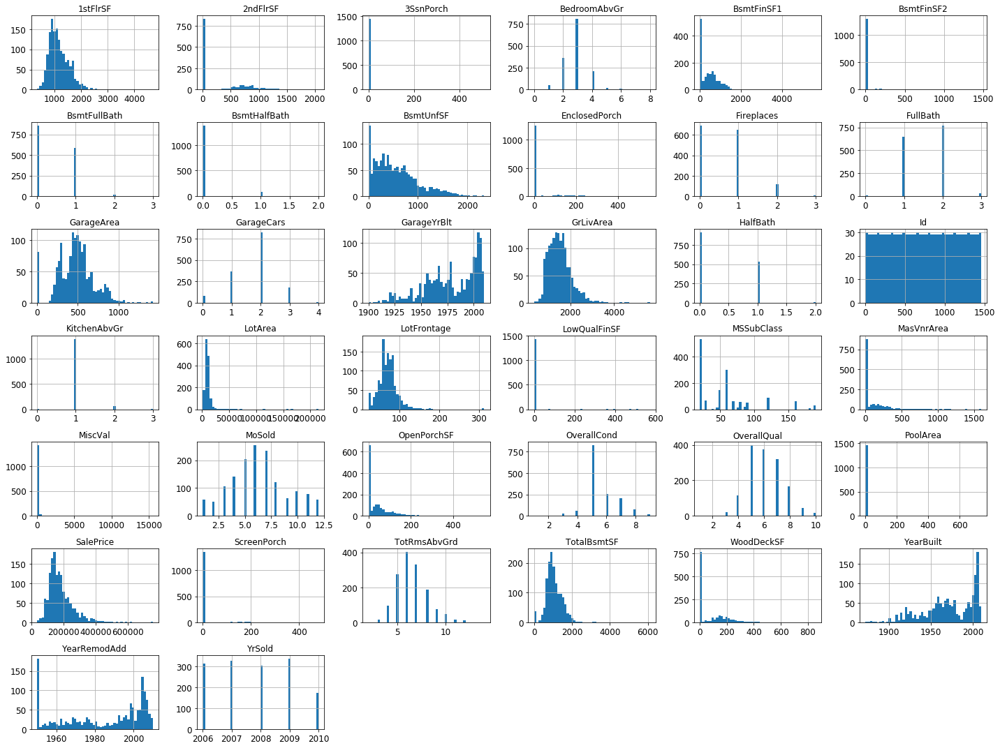

In [50]:
%matplotlib inline
import matplotlib.pyplot as plt
housing.hist(bins=50, figsize=(20,15))
save_fig("attribute_histogram_plots")
plt.show()

In [51]:
housing.columns

Index(['Id', 'MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street',
       'LotShape', 'LandContour', 'Utilities', 'LotConfig', 'LandSlope',
       'Neighborhood', 'Condition1', 'Condition2', 'BldgType', 'HouseStyle',
       'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd', 'RoofStyle',
       'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'MasVnrArea',
       'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond',
       'BsmtExposure', 'BsmtFinType1', 'BsmtFinSF1', 'BsmtFinType2',
       'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', 'Heating', 'HeatingQC',
       'CentralAir', 'Electrical', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF',
       'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual', 'TotRmsAbvGrd',
       'Functional', 'Fireplaces', 'GarageType', 'GarageYrBlt', 'GarageFinish',
       'GarageCars', 'GarageArea', 'GarageQual', 'GarageCond', 'PavedDrive',
       'WoodDeckSF', 'OpenPo

Saving figure scatter_matrix_plot


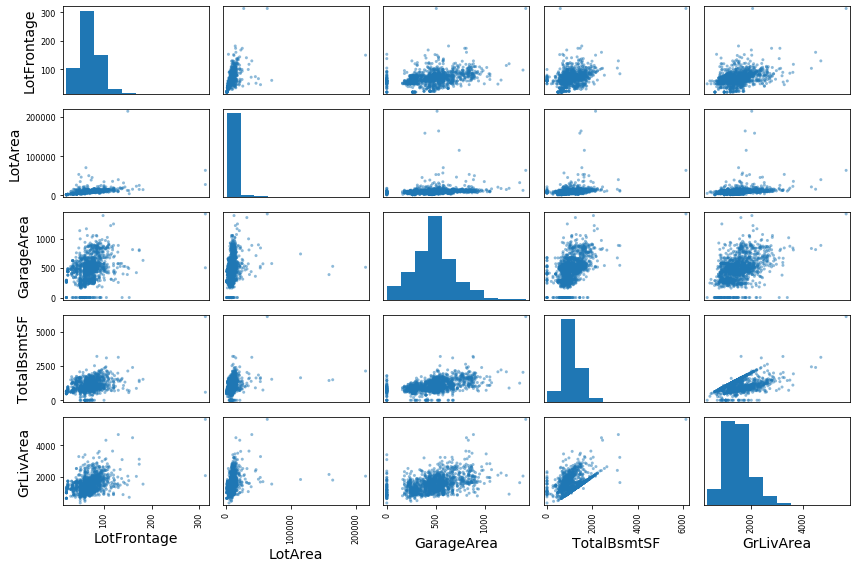

In [52]:
#scatter matrix for continuous value features
from pandas.plotting import scatter_matrix

cont_features = ['LotFrontage', 'LotArea','GarageArea', 'TotalBsmtSF', 'GrLivArea']

scatter_matrix(housing[cont_features], figsize=(12, 8))
save_fig("scatter_matrix_plot")

In [53]:
#Correlation Report
housing.corr()['SalePrice'].sort_values(ascending=False)

SalePrice        1.000000
OverallQual      0.790982
GrLivArea        0.708624
GarageCars       0.640409
GarageArea       0.623431
TotalBsmtSF      0.613581
1stFlrSF         0.605852
FullBath         0.560664
TotRmsAbvGrd     0.533723
YearBuilt        0.522897
YearRemodAdd     0.507101
GarageYrBlt      0.486362
MasVnrArea       0.477493
Fireplaces       0.466929
BsmtFinSF1       0.386420
LotFrontage      0.351799
WoodDeckSF       0.324413
2ndFlrSF         0.319334
OpenPorchSF      0.315856
HalfBath         0.284108
LotArea          0.263843
BsmtFullBath     0.227122
BsmtUnfSF        0.214479
BedroomAbvGr     0.168213
ScreenPorch      0.111447
PoolArea         0.092404
MoSold           0.046432
3SsnPorch        0.044584
BsmtFinSF2      -0.011378
BsmtHalfBath    -0.016844
MiscVal         -0.021190
Id              -0.021917
LowQualFinSF    -0.025606
YrSold          -0.028923
OverallCond     -0.077856
MSSubClass      -0.084284
EnclosedPorch   -0.128578
KitchenAbvGr    -0.135907
Name: SalePr

Saving figure top_10_linear_features


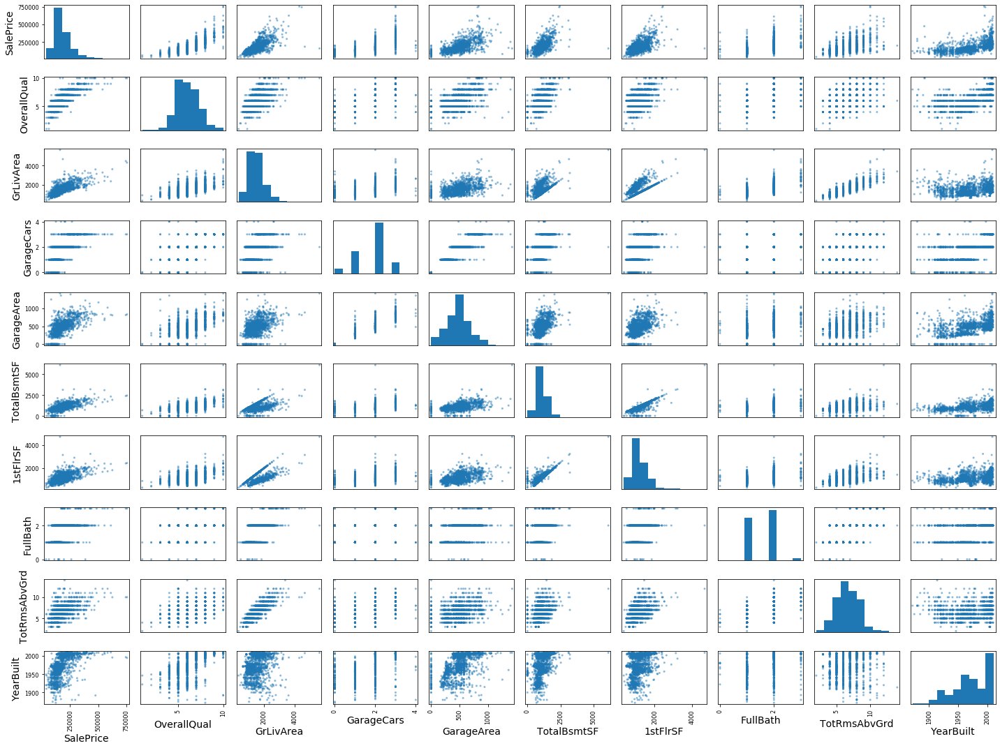

In [54]:
def plot_top_10_linear_corr_features():
    #top 5 df
    top_10_linear_features = housing[abs(housing.corr()['SalePrice']).sort_values(ascending=False).index.values[0:10]]

    #plot and save
    scatter_matrix(top_10_linear_features, figsize=(20, 15))
    save_fig("top_10_linear_features")

    return top_10_linear_features

top_10_linear_features = plot_top_10_linear_corr_features()

## Focusing on a subset of the top 10 features

### Specifically because I'm trying to find a generalized sale price based on a linear model

In [55]:
top_10_linear_features.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 10 columns):
SalePrice       1460 non-null int64
OverallQual     1460 non-null int64
GrLivArea       1460 non-null int64
GarageCars      1460 non-null int64
GarageArea      1460 non-null int64
TotalBsmtSF     1460 non-null int64
1stFlrSF        1460 non-null int64
FullBath        1460 non-null int64
TotRmsAbvGrd    1460 non-null int64
YearBuilt       1460 non-null int64
dtypes: int64(10)
memory usage: 114.2 KB


In [56]:
#Adding ID column to the new focussed set of features
temp_feature_list = top_10_linear_features.columns.to_list()
temp_feature_list.append('Id')

#Creating a trimmed housing dataset (subset)
housing = housing[temp_feature_list]

#Re-arranging housing df to keep Id column first and SalePrice (target) last (I like to see my dataset this way. No other reason)
housing = housing['Id', 'OverallQual', 'GrLivArea', 'GarageCars', 'GarageArea',
       'TotalBsmtSF', '1stFlrSF', 'FullBath', 'TotRmsAbvGrd', 'YearBuilt','SalePrice']


,SalePrice,OverallQual,GrLivArea,GarageCars,GarageArea,TotalBsmtSF,1stFlrSF,FullBath,TotRmsAbvGrd,YearBuilt,Id
0,208500,7,1710,2,548,856,856,2,8,2003,1
1,181500,6,1262,2,460,1262,1262,2,6,1976,2
2,223500,7,1786,2,608,920,920,2,6,2001,3
3,140000,7,1717,3,642,756,961,1,7,1915,4
4,250000,8,2198,3,836,1145,1145,2,9,2000,5


In [57]:
##Re-check to see if there are any missing features in our dataset
missing_value_percentage = calculate_missing_value_percentage(housing)
missing_value_percentage.head()

,Feature,Percentage
0,SalePrice,0.0
1,OverallQual,0.0
2,GrLivArea,0.0
3,GarageCars,0.0
4,GarageArea,0.0


In [62]:
housing.describe()

,Id,OverallQual,GrLivArea,GarageCars,GarageArea,TotalBsmtSF,1stFlrSF,FullBath,TotRmsAbvGrd,YearBuilt,SalePrice
count,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,730.500000,6.099315,1515.463699,1.767123,472.980137,1057.429452,1162.626712,1.565068,6.517808,1971.267808,180921.195890
std,421.610009,1.382997,525.480383,0.747315,213.804841,438.705324,386.587738,0.550916,1.625393,30.202904,79442.502883
min,1.000000,1.000000,334.000000,0.000000,0.000000,0.000000,334.000000,0.000000,2.000000,1872.000000,34900.000000
25%,365.750000,5.000000,1129.500000,1.000000,334.500000,795.750000,882.000000,1.000000,5.000000,1954.000000,129975.000000
50%,730.500000,6.000000,1464.000000,2.000000,480.000000,991.500000,1087.000000,2.000000,6.000000,1973.000000,163000.000000
75%,1095.250000,7.000000,1776.750000,2.000000,576.000000,1298.250000,1391.250000,2.000000,7.000000,2000.000000,214000.000000
max,1460.000000,10.000000,5642.000000,4.000000,1418.000000,6110.000000,4692.000000,3.000000,14.000000,2010.000000,755000.000000


In [73]:
#both '1stFlrSF' and 'GrLivArea' distributions have fat tails. Takign the log of these #to normalize them
def normalize_these_columns(df, col_list):
    for col in col_list:
        df[col] = df[col].apply(lambda x:np.log(x))

    return df

col_list = ['1stFlrSF', 'GrLivArea' ]

housing = normalize_these_columns(housing, col_list)


,Id,OverallQual,GrLivArea,GarageCars,GarageArea,TotalBsmtSF,1stFlrSF,FullBath,TotRmsAbvGrd,YearBuilt,SalePrice
count,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,730.500000,6.099315,7.267774,1.767123,472.980137,1057.429452,7.007501,1.565068,6.517808,1971.267808,180921.195890
std,421.610009,1.382997,0.333550,0.747315,213.804841,438.705324,0.317730,0.550916,1.625393,30.202904,79442.502883
min,1.000000,1.000000,5.811141,0.000000,0.000000,0.000000,5.811141,0.000000,2.000000,1872.000000,34900.000000
25%,365.750000,5.000000,7.029530,1.000000,334.500000,795.750000,6.782192,1.000000,5.000000,1954.000000,129975.000000
50%,730.500000,6.000000,7.288928,2.000000,480.000000,991.500000,6.991176,2.000000,6.000000,1973.000000,163000.000000
75%,1095.250000,7.000000,7.482541,2.000000,576.000000,1298.250000,7.237958,2.000000,7.000000,2000.000000,214000.000000
max,1460.000000,10.000000,8.637994,4.000000,1418.000000,6110.000000,8.453614,3.000000,14.000000,2010.000000,755000.000000


In [75]:
#Overall quality seems to be an important indicator of sale price. 
# To ensure training is done with sampling bias in mind, let's do stratified sampling
from sklearn.model_selection import StratifiedShuffleSplit

split = StratifiedShuffleSplit(n_splits=1, test_size=0.2, random_state=42)
for train_index, test_index in split.split(housing, housing["OverallQual"]):
    strat_train_set = housing.loc[train_index]
    strat_test_set = housing.loc[test_index]

In [76]:
strat_train_set

,Id,OverallQual,GrLivArea,GarageCars,GarageArea,TotalBsmtSF,1stFlrSF,FullBath,TotRmsAbvGrd,YearBuilt,SalePrice
825,826,10,7.642044,3,1220,2078,7.642044,2,7,2007,385000
948,949,7,7.482119,2,474,936,6.841615,2,7,2002,192500
188,189,5,7.109879,2,528,1086,7.109879,0,6,1979,153337
1059,1060,6,7.596392,2,432,854,6.999422,1,7,1932,220000
667,668,6,7.425954,2,575,1408,7.425954,2,7,1994,193500
...,...,...,...,...,...,...,...,...,...,...,...
45,46,9,7.468513,2,576,1752,7.468513,2,6,2005,319900
180,181,6,7.329750,2,440,756,6.645091,2,5,2000,177000
1090,1091,3,6.946976,2,400,0,6.946976,2,6,1950,92900
1368,1369,6,6.742881,2,420,848,6.742881,1,4,2003,144000


Saving figure liv_area_vs_sale_price_scatterplot


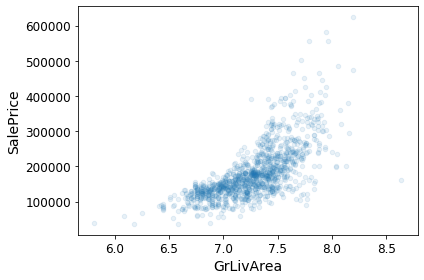

In [78]:
strat_train_set.plot(kind="scatter", x="GrLivArea", y="SalePrice",
             alpha=0.1)
save_fig("liv_area_vs_sale_price_scatterplot")

## Prep data for ML algorithms

In [79]:
housing = strat_train_set.drop("SalePrice", axis=1) # drop target label for training set
housing_labels = strat_train_set["SalePrice"].copy()

In [80]:
#Although in this case our features don't have NaNs, what if they did?
# We will use a median value based imputer in this case (usually will depend on which feature value is missing and its use/significance)

from sklearn.impute import SimpleImputer
imputer = SimpleImputer(strategy="median")

imputer.fit(housing)

print*"Imputer Stats and startegy : "
print(imputer_statistics_)
print(imputer.startegy)

X = imputer.transform(housing)

,Id,OverallQual,GrLivArea,GarageCars,GarageArea,TotalBsmtSF,1stFlrSF,FullBath,TotRmsAbvGrd,YearBuilt
825,826,10,7.642044,3,1220,2078,7.642044,2,7,2007
948,949,7,7.482119,2,474,936,6.841615,2,7,2002
188,189,5,7.109879,2,528,1086,7.109879,0,6,1979
1059,1060,6,7.596392,2,432,854,6.999422,1,7,1932
667,668,6,7.425954,2,575,1408,7.425954,2,7,1994
...,...,...,...,...,...,...,...,...,...,...
45,46,9,7.468513,2,576,1752,7.468513,2,6,2005
180,181,6,7.329750,2,440,756,6.645091,2,5,2000
1090,1091,3,6.946976,2,400,0,6.946976,2,6,1950
1368,1369,6,6.742881,2,420,848,6.742881,1,4,2003


In [ ]:
ues